In [2]:
import pandas as pd

In [3]:
results_df = pd.read_csv('results_gauss.csv')

In [4]:
results_df 

,Unnamed: 0,Filename,A,B,C,Time (s)
0,0,00000001.txt,6.016165e+06,1.383070,0.134680,0.036606
1,1,00000002.txt,5.996164e+06,1.382989,0.134886,0.536500
2,2,00000003.txt,6.010415e+06,1.382889,0.134970,1.036430
3,3,00000004.txt,5.999819e+06,1.382968,0.134904,1.536421
4,4,00000005.txt,6.002321e+06,1.382615,0.135196,2.036358
...,...,...,...,...,...,...
7175,7175,00007176.txt,5.223600e+06,1.385339,0.136119,3587.154000
7176,7176,00007177.txt,5.223475e+06,1.385518,0.135866,3587.656000
7177,7177,00007178.txt,5.213699e+06,1.385069,0.136473,3588.161000
7178,7178,00007179.txt,5.222123e+06,1.385309,0.136355,3588.654000


In [29]:
results_df['Gaussian_Area'] = results_df.apply(integrate_gaussian, axis=1)

In [31]:
results_df.to_excel('results_gauss_integr.xlsx')

In [4]:
results_df['Reduce'] = results_df['Time (s)'].apply(lambda x: abs(x - round(x)) )
results_df['Number'] = results_df['Time (s)'].round()

In [5]:
results_df

,Unnamed: 0,Filename,A,B,C,Time (s),Reduce,Number
0,0,00000001.txt,6.016165e+06,1.383070,0.134680,0.036606,0.036606,0.0
1,1,00000002.txt,5.996164e+06,1.382989,0.134886,0.536500,0.463500,1.0
2,2,00000003.txt,6.010415e+06,1.382889,0.134970,1.036430,0.036430,1.0
3,3,00000004.txt,5.999819e+06,1.382968,0.134904,1.536421,0.463579,2.0
4,4,00000005.txt,6.002321e+06,1.382615,0.135196,2.036358,0.036358,2.0
...,...,...,...,...,...,...,...,...
7175,7175,00007176.txt,5.223600e+06,1.385339,0.136119,3587.154000,0.154000,3587.0
7176,7176,00007177.txt,5.223475e+06,1.385518,0.135866,3587.656000,0.344000,3588.0
7177,7177,00007178.txt,5.213699e+06,1.385069,0.136473,3588.161000,0.161000,3588.0
7178,7178,00007179.txt,5.222123e+06,1.385309,0.136355,3588.654000,0.346000,3589.0


In [6]:
n_list = []
for n in results_df['Number'].unique():
    df_n = results_df[results_df['Number'] == n]
    n_list.append(df_n)

In [51]:
vals = []
for u in range(len(n_list)):
    val = n_list[u][n_list[u]['Reduce'] == min(n_list[u]['Reduce'])]
    vals.append(val)

In [54]:
wholes = pd.concat(vals)[['Filename', 'A', 'B', 'C', 'Time (s)']]

In [10]:
wholes = pd.read_excel('results_wholes.xlsx')

In [8]:
wholes['Time (s)'] = wholes['Time (s)'].round()

In [9]:
wholes['Time (s)']

,Unnamed: 0,Filename,A,B,C,Time (s)
0,0,00000001.txt,6.016165e+06,1.383070,0.134680,0.0
1,2,00000003.txt,6.010415e+06,1.382889,0.134970,1.0
2,4,00000005.txt,6.002321e+06,1.382615,0.135196,2.0
3,6,00000007.txt,6.014183e+06,1.383273,0.134404,3.0
4,8,00000009.txt,6.015592e+06,1.383079,0.134579,4.0
...,...,...,...,...,...,...
3591,7171,00007172.txt,5.229966e+06,1.385639,0.136112,3585.0
3592,7173,00007174.txt,5.222887e+06,1.384998,0.136536,3586.0
3593,7175,00007176.txt,5.223600e+06,1.385339,0.136119,3587.0
3594,7177,00007178.txt,5.213699e+06,1.385069,0.136473,3588.0


In [15]:
df_filtered = wholes.iloc[::600]

# If you want to reset the index of the new DataFrame
df_filtered.reset_index(drop=True, inplace=True)

# Add the last row from the initial DataFrame
last_row = wholes.iloc[-1]
df_filtered = pd.concat([df_filtered, last_row.to_frame().T], ignore_index=True)

# Display the resulting DataFrame
df_filtered.to_excel('each_600s.xlsx')

In [16]:
df_filtered

,Unnamed: 0,Filename,A,B,C,Time (s)
0,0,00000001.txt,6016164.548224,1.38307,0.13468,0.036606
1,1200,00001201.txt,5830957.501299,1.384179,0.13468,599.972
2,2400,00002401.txt,5680775.784648,1.384182,0.136102,1199.911
3,3600,00003601.txt,5553785.848316,1.384484,0.136242,1799.844
4,4800,00004801.txt,5443194.431646,1.38477,0.136186,2399.78
5,5989,00005990.txt,5332556.149002,1.385555,0.135296,2994.217
6,7179,00007180.txt,5218812.324198,1.38534,0.136153,3589.154


In [10]:
best_approx = pd.read_excel(r'C:\Users\ivan\SCIENSE\QuantumDots\все модели\GLM\GLM_4.xlsx')

In [22]:
best_approx#[['A', 'B', 'C']]

,Unnamed: 0,Time (s),A,B,C
0,0,0,5.573769e+06,1.384403,0.13594
1,1,1,5.573769e+06,1.384403,0.13594
2,2,2,5.573769e+06,1.384403,0.13594
3,3,3,5.573769e+06,1.384403,0.13594
4,4,4,5.573769e+06,1.384403,0.13594
...,...,...,...,...,...
10796,10796,10796,8.226703e+03,1.384403,0.13594
10797,10797,10797,8.206856e+03,1.384403,0.13594
10798,10798,10798,8.187051e+03,1.384403,0.13594
10799,10799,10799,8.167288e+03,1.384403,0.13594


In [34]:
import numpy as np
from scipy.integrate import quad

# Assuming df is your DataFrame with columns A, B, and C
# Replace 'A', 'B', 'C' with the actual column names if different

# Function for the Gaussian curve
def gaussian_curve(x, A, B, C):
    return A * np.exp(-((x - B) ** 2) / (C ** 2))

# Function to integrate the Gaussian curve
def integrate_gaussian(row):
    A = row['A']
    B = row['B']
    C = row['C']

    # Define the integration limits, for example, from -infinity to +infinity
    integration_limits = [-np.inf, np.inf]

    # Use quad to perform numerical integration
    result, _ = quad(gaussian_curve, *integration_limits, args=(A, B, C))
    return result

# Create a new column 'Gaussian_Area' in the DataFrame
#best_approx['Gaussian_Area'] = best_approx.apply(integrate_gaussian, axis=1)


In [25]:
best_approx.to_excel('GLM4_integrs.xlsx')

In [20]:
df_filtered = best_approx.iloc[::600]

# If you want to reset the index of the new DataFrame
df_filtered.reset_index(drop=True, inplace=True)

# Add the last row from the initial DataFrame
last_row = best_approx.iloc[-1]
df_filtered = pd.concat([df_filtered, last_row.to_frame().T], ignore_index=True)

In [22]:
df_filtered.to_excel('approx_each_600s.xlsx')

Optimized Parameters:
A: 5985093.3595010815
B: 1.3821463755548637
C: 0.13654432251665932
Optimized Parameters:
A: 5800514.354959591
B: 1.3832370838724428
C: 0.1365707993002723
Optimized Parameters:
A: 5643677.197016712
B: 1.382979437459651
C: 0.13849694275254076
Optimized Parameters:
A: 5515960.408920666
B: 1.3832127361605842
C: 0.1387570520786775
Optimized Parameters:
A: 5411193.292953613
B: 1.383700031654192
C: 0.13833729280859156
Optimized Parameters:
A: 5292490.2460823525
B: 1.384192902216558
C: 0.1380351374975953


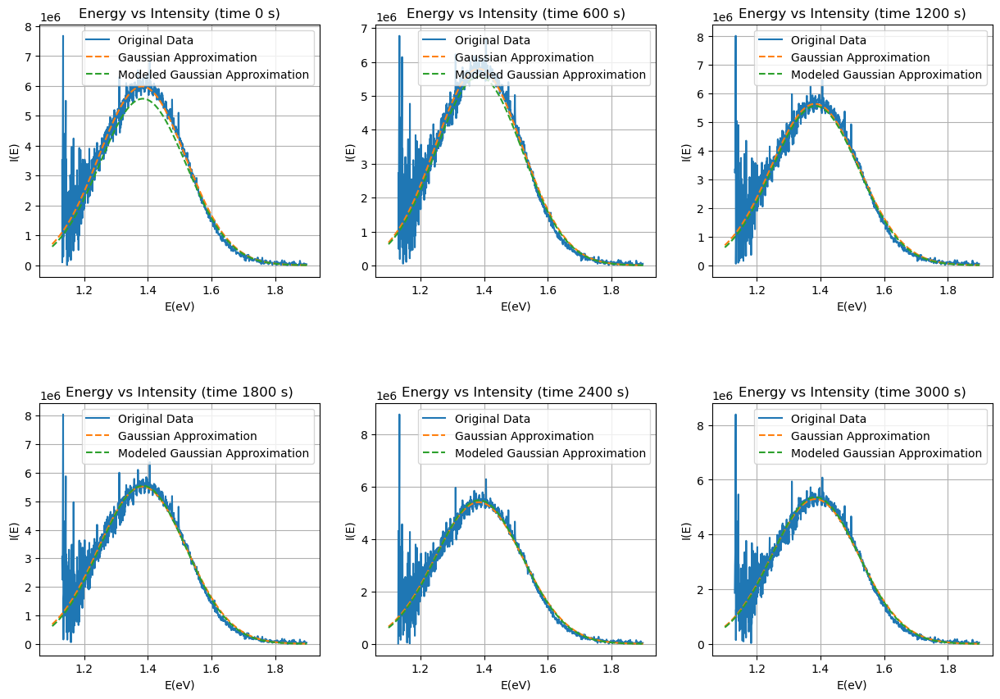

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
import glob
import os

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and plot
def fit_and_plot(ax, filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.9) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)
       
    filename_with_extension = os.path.basename(filename)
    params_approx = list(final[final['Filename'] == filename_with_extension][['A_pred', 'B_pred', 'C_pred']].iloc[0])
    
    # Plot the original data
    ax.plot(filtered_df['E(eV)'], filtered_df['I(E)'], label='Original Data')

    # Plot the Gaussian approximation
    x_range = np.linspace(1.1, 1.9, 100)
    ax.plot(x_range, gaussian(x_range, *params), label='Gaussian Approximation', linestyle='--')
    ax.plot(x_range, gaussian(x_range, *params_approx), label='Modeled Gaussian Approximation', linestyle='--')
    
    ax.set_xlabel('E(eV)')
    ax.set_ylabel('I(E)')
    ax.set_title(f"Energy vs Intensity (time {list(final[final['Filename'] == filename_with_extension]['Time (s)_pred'])[0]} s)")
    ax.legend()
    ax.grid(True)

    # Display the optimized parameters A, B, and C
    print('Optimized Parameters:')
    print('A:', params[0])
    print('B:', params[1])
    print('C:', params[2])


list_files = list(final['Filename'])
file_list = [r'D:\python\DATAS\lumin\{}'.format(file) for file in list_files]

# Create subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
fig.subplots_adjust(hspace=0.5)

# Iterate through every 600th file and perform the analysis
for i in range(min(len(file_list), 6)):  # Limit to the number of available subplots (2 rows, 3 columns)
    row, col = divmod(i, 3)
    fit_and_plot(axs[row, col], file_list[i])

plt.savefig('EnergyVSintensity.pdf')
plt.show()



The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


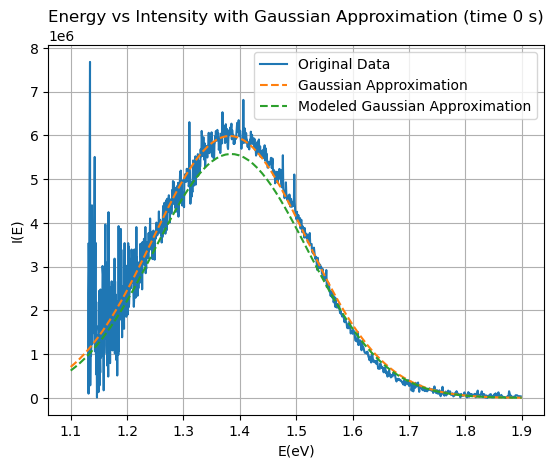

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5985093.3595010815
B: 1.3821463755548637
C: 0.13654432251665932


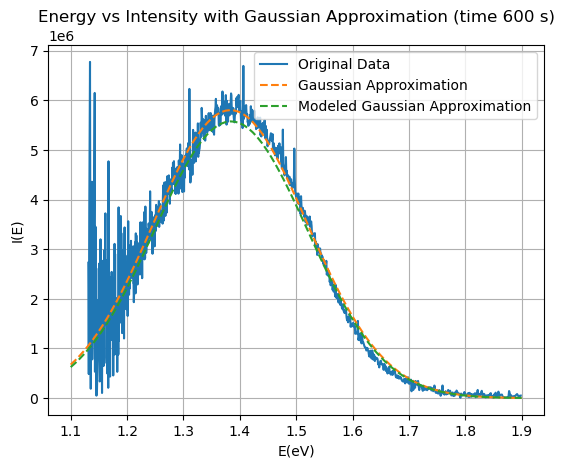

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5800514.354959591
B: 1.3832370838724428
C: 0.1365707993002723


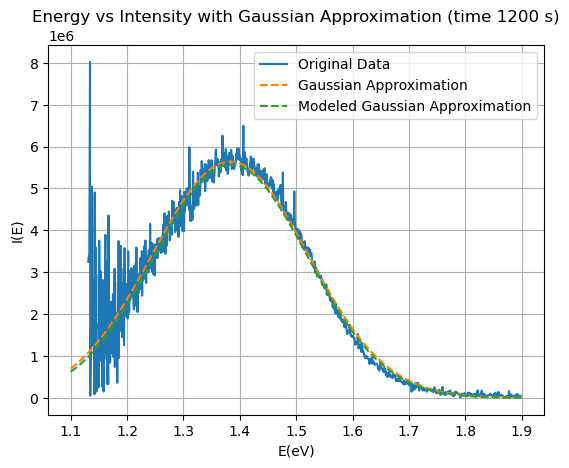

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5643677.197016712
B: 1.382979437459651
C: 0.13849694275254076


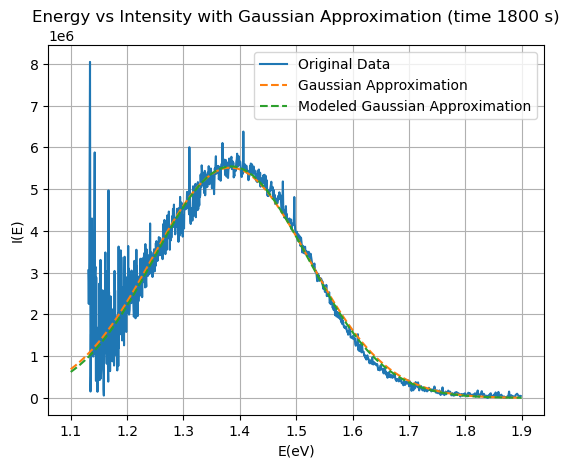

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5515960.408920666
B: 1.3832127361605842
C: 0.1387570520786775


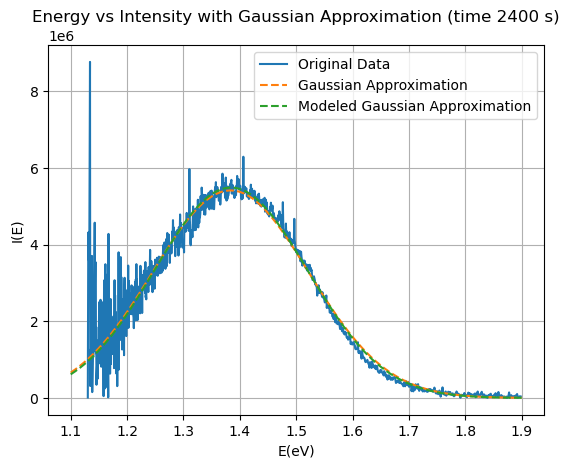

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5411193.292953613
B: 1.383700031654192
C: 0.13833729280859156


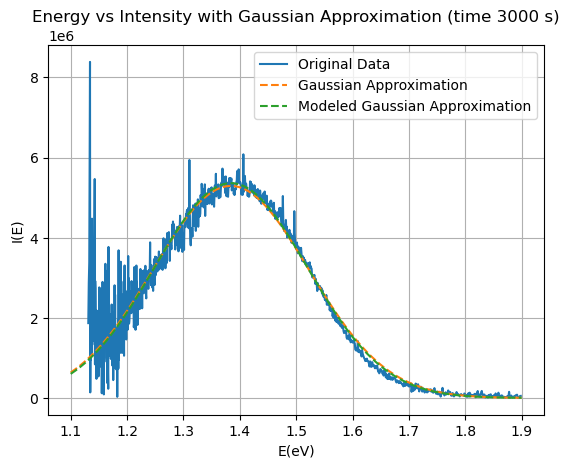

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Optimized Parameters:
A: 5292490.2460823525
B: 1.384192902216558
C: 0.1380351374975953


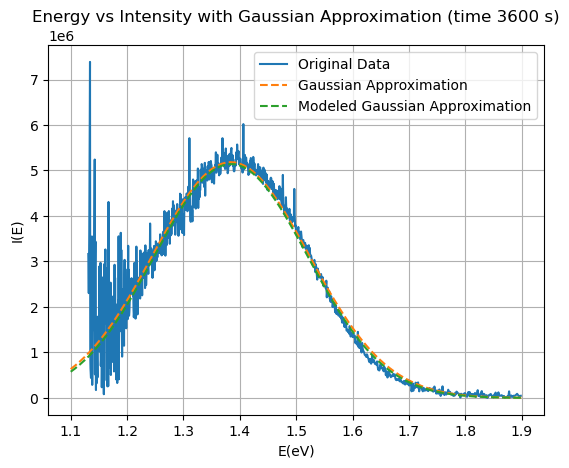

Optimized Parameters:
A: 5183587.660793899
B: 1.3840991154790778
C: 0.13862958928348496


In [20]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
import glob
import os

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and plot
def fit_and_plot(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.9) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)
       
    filename_with_extension = os.path.basename(filename)
    params_approx = list(final[final['Filename'] == filename_with_extension][['A_pred', 'B_pred', 'C_pred']].iloc[0])
    
    # Plot the original data
    plt.plot(filtered_df['E(eV)'], filtered_df['I(E)'], label='Original Data')

    # Plot the Gaussian approximation
    x_range = np.linspace(1.1, 1.9, 100)
    plt.plot(x_range, gaussian(x_range, *params), label='Gaussian Approximation', linestyle='--')
    plt.plot(x_range, gaussian(x_range, *params_approx), label='Modeled Gaussian Approximation', linestyle='--')
    
    plt.xlabel('E(eV)')
    plt.ylabel('I(E)')
    plt.title(f"Energy vs Intensity with Gaussian Approximation (time {list(final[final['Filename'] == filename_with_extension]['Time (s)_pred'])[0]} s)")
    plt.legend()
    plt.grid(True)
    plt.savefig(f'{filename_with_extension}_approxes.eps')
    plt.show()

    # Display the optimized parameters A, B, and C
    print('Optimized Parameters:')
    print('A:', params[0])
    print('B:', params[1])
    print('C:', params[2])


list_files = list(final['Filename'])
file_list = [r'D:\python\DATAS\lumin\{}'.format(file) for file in list_files]


# Iterate through every 600th file and perform the analysis
for i in range(len(file_list)):
    fit_and_plot(file_list[i])


In [5]:
final = pd.read_excel('each_600s.xlsx')

In [12]:
final#[['A_pred', 'B_pred', 'C_pred']]

,Unnamed: 0.2,Unnamed: 0,Filename,A,B,C,Time (s),Unnamed: 0.1,Time (s)_pred,A_pred,B_pred,C_pred
0,0,0,00000001.txt,6.016165e+06,1.383070,0.134680,0.036606,0,0,5.573769e+06,1.384403,0.13594
1,1,1200,00001201.txt,5.830958e+06,1.384179,0.134680,599.972000,600,600,5.573422e+06,1.384403,0.13594
2,2,2400,00002401.txt,5.680776e+06,1.384182,0.136102,1199.911000,1200,1200,5.568226e+06,1.384403,0.13594
3,3,3600,00003601.txt,5.553786e+06,1.384484,0.136242,1799.844000,1800,1800,5.545764e+06,1.384403,0.13594
4,4,4800,00004801.txt,5.443194e+06,1.384770,0.136186,2399.780000,2400,2400,5.485738e+06,1.384403,0.13594
5,5,5989,00005990.txt,5.332556e+06,1.385555,0.135296,2994.217000,3000,3000,5.361291e+06,1.384403,0.13594
6,6,7179,00007180.txt,5.218812e+06,1.385340,0.136153,3589.154000,3600,3600,5.142182e+06,1.384403,0.13594


In [16]:
list(final[final['Filename'] == '00001201.txt']['Time (s)_pred'])[0]

600

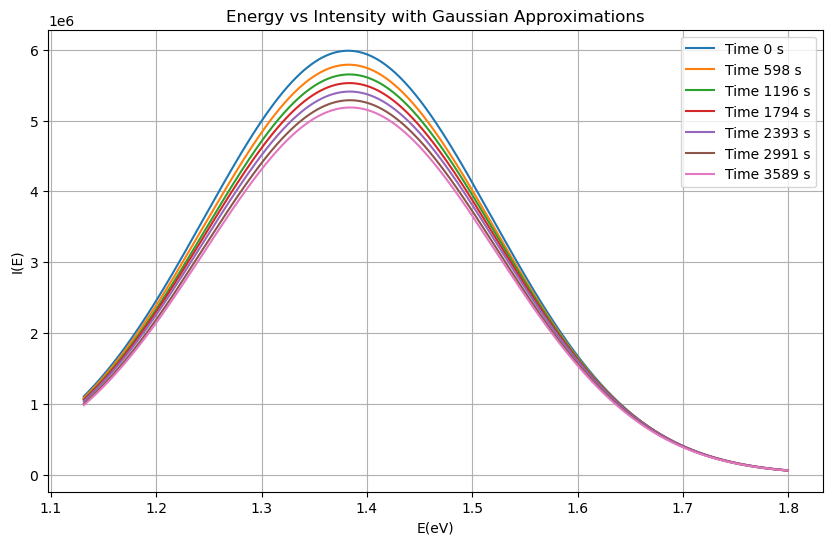

In [48]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
import glob

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and accumulate data
def fit_and_accumulate(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.8) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)

    return filtered_df['E(eV)'], gaussian(filtered_df['E(eV)'], *params)

# Get a list of all .txt files in the specified directory
file_list = glob.glob(r'D:\python\DATAS\lumin\*.txt')

# Plot all Gaussian approximations on one figure
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y = fit_and_accumulate(file_list[i])
    plt.plot(x, y, label=f'Time {i//2} s')

plt.xlabel('E(eV)')
plt.ylabel('I(E)')
plt.title('Energy vs Intensity with Gaussian Approximations')
plt.legend()
plt.grid(True)
plt.savefig('spectrs.pdf')
plt.show()


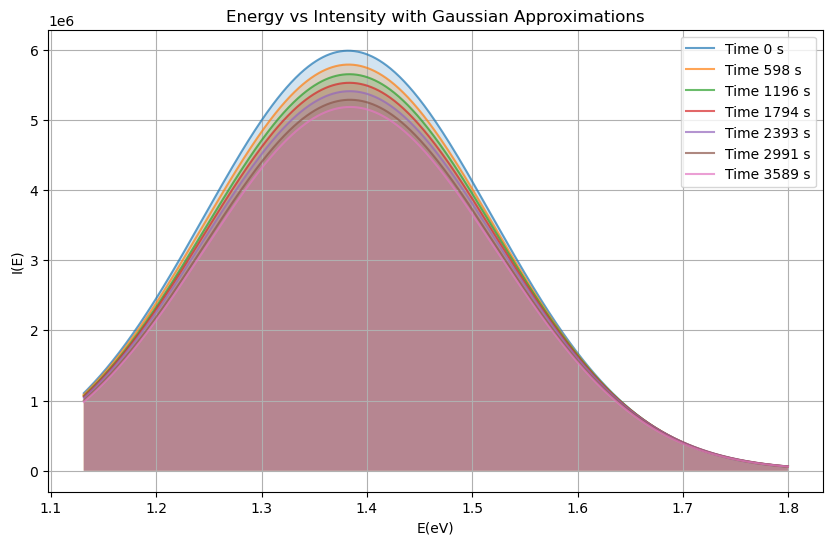

In [74]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
import glob

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and accumulate data
def fit_and_accumulate(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.8) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)

    return filtered_df['E(eV)'], gaussian(filtered_df['E(eV)'], *params)

# Get a list of all .txt files in the specified directory
file_list = glob.glob(r'D:\python\DATAS\lumin\*.txt')

# Plot all Gaussian approximations on one figure
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y = fit_and_accumulate(file_list[i])
    plt.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency

    # Highlight the area under the curve
    plt.fill_between(x, 0, y, alpha=0.2)

plt.xlabel('E(eV)')
plt.ylabel('I(E)')
plt.title('Energy vs Intensity with Gaussian Approximations')
plt.legend()
plt.grid(True)
plt.savefig('spectrs_.pdf')
plt.show()


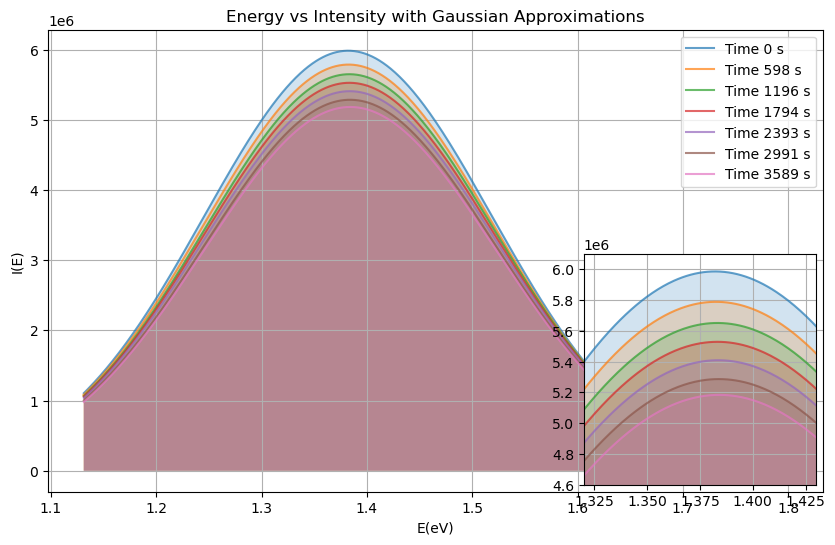

In [84]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

import numpy as np
import glob

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and accumulate data
def fit_and_accumulate(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.8) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)

    return filtered_df['E(eV)'], gaussian(filtered_df['E(eV)'], *params)

# Get a list of all .txt files in the specified directory
file_list = glob.glob(r'D:\python\DATAS\lumin\*.txt')

# Plot all Gaussian approximations on one figure
fig, ax = plt.subplots(figsize=(10, 6))  # Adjust the figure size as needed

for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y = fit_and_accumulate(file_list[i])
    ax.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency

    # Highlight the area under the curve
    ax.fill_between(x, 0, y, alpha=0.2)

# Zoomed-in inset
inset_axes = inset_axes(ax, width='30%', height='50%', loc='lower right')
for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y = fit_and_accumulate(file_list[i])
    inset_axes.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency
    inset_axes.fill_between(x, 0, y, alpha=0.2)
inset_axes.set_xlim(1.32, 1.43)
inset_axes.set_ylim(4.6e6, 6.1e6)
inset_axes.grid(True)

ax.set_xlabel('E(eV)')
ax.set_ylabel('I(E)')
ax.set_title('Energy vs Intensity with Gaussian Approximations')
ax.legend()
ax.grid(True)

plt.savefig('spectrs_with_inset.pdf')
plt.show()


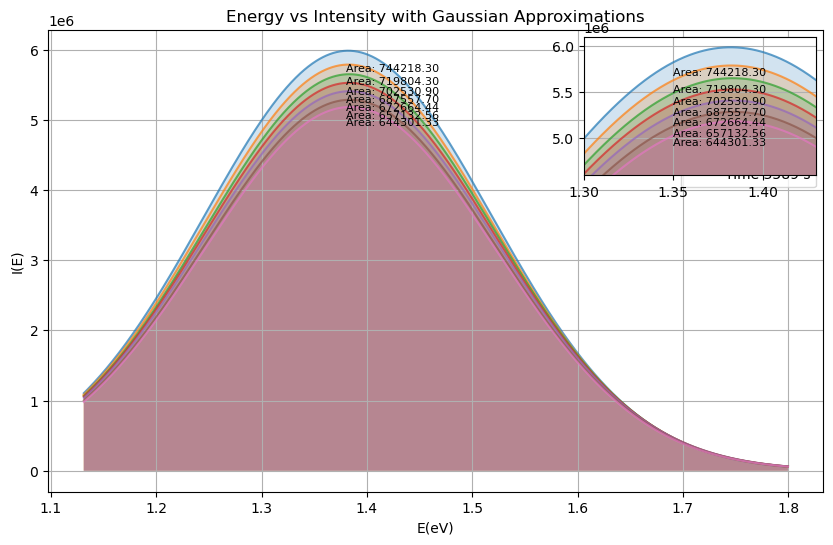

In [85]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.integrate import quad
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

import numpy as np
import glob

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and accumulate data
def fit_and_accumulate(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.8) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)

    # Compute the area under the curve within the specified x-range
    area, _ = quad(gaussian, 1.3, 1.43, args=tuple(params))

    return filtered_df['E(eV)'], gaussian(filtered_df['E(eV)'], *params), area

# Get a list of all .txt files in the specified directory
file_list = glob.glob(r'D:\python\DATAS\lumin\*.txt')

# Plot all Gaussian approximations on one figure
fig, ax = plt.subplots(figsize=(10, 6))  # Adjust the figure size as needed

for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y, area = fit_and_accumulate(file_list[i])
    ax.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency

    # Highlight the area under the curve
    ax.fill_between(x, 0, y, alpha=0.2)

    # Print the area value on the plot
    ax.text(1.38, 0.95 * max(y), f'Area: {area:.2f}', fontsize=8, color='black')

# Zoomed-in inset
inset_axes = inset_axes(ax, width='30%', height='30%', loc='upper right')
for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y, area = fit_and_accumulate(file_list[i])
    inset_axes.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency
    inset_axes.fill_between(x, 0, y, alpha=0.2)

    # Print the area value on the inset
    inset_axes.text(1.35, 0.95 * max(y), f'Area: {area:.2f}', fontsize=8, color='black')

inset_axes.set_xlim(1.3, 1.43)
inset_axes.set_ylim(4.6e6, 6.1e6)
inset_axes.grid(True)

ax.set_xlabel('E(eV)')
ax.set_ylabel('I(E)')
ax.set_title('Energy vs Intensity with Gaussian Approximations')
ax.legend()
ax.grid(True)

plt.savefig('spectrs_with_inset_and_values.pdf')
plt.show()


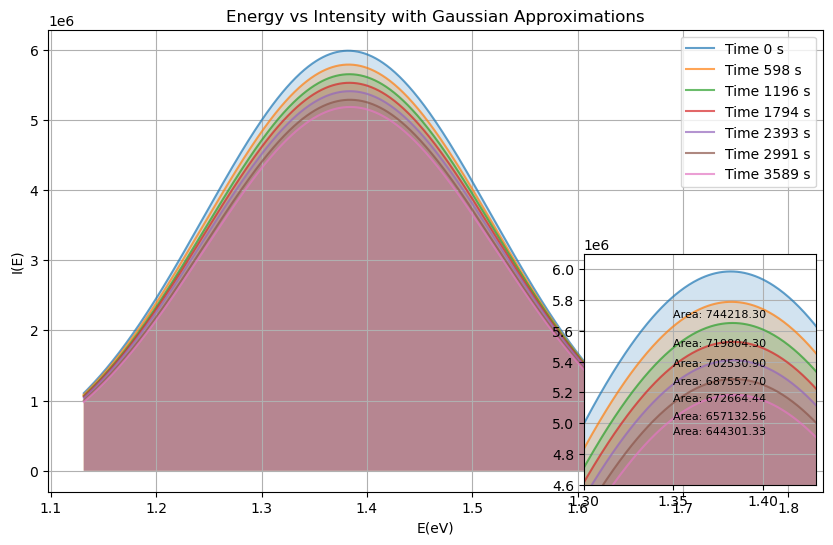

In [87]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.integrate import quad
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

import numpy as np
import glob

# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Function to fit Gaussian and accumulate data
def fit_and_accumulate(filename):
    # Read the dataset into a pandas DataFrame
    df = pd.read_csv(filename, comment='#', delim_whitespace=True, header=None,
                     names=['N', 'V', 'wl(nm)', 'I(wl)', 'E(eV)', 'I(E)'])

    # Filter the DataFrame based on the range of 'E(eV)'
    filtered_df = df[(df['E(eV)'] >= 1.13) & (df['E(eV)'] <= 1.8) & (df['I(E)'] > 0)]

    # Initial guess for the parameters A, B, and C
    initial_guess = [max(filtered_df['I(E)']), filtered_df['E(eV)'].mean(), 0.1]

    # Fit the Gaussian function to the data
    params, covariance = curve_fit(gaussian, filtered_df['E(eV)'], filtered_df['I(E)'], p0=initial_guess)

    # Compute the area under the curve within the specified x-range
    area, _ = quad(gaussian, 1.3, 1.43, args=tuple(params))

    return filtered_df['E(eV)'], gaussian(filtered_df['E(eV)'], *params), area

# Get a list of all .txt files in the specified directory
file_list = glob.glob(r'D:\python\DATAS\lumin\*.txt')

# Plot all Gaussian approximations on one figure
fig, ax = plt.subplots(figsize=(10, 6))  # Adjust the figure size as needed

for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y, area = fit_and_accumulate(file_list[i])
    ax.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency

    # Highlight the area under the curve
    ax.fill_between(x, 0, y, alpha=0.2)

# Zoomed-in inset
inset_axes = inset_axes(ax, width='30%', height='50%', loc='lower right')
for i in np.linspace(0, len(file_list)-1, 7, dtype=int):
    x, y, area = fit_and_accumulate(file_list[i])
    inset_axes.plot(x, y, label=f'Time {i//2} s', alpha=0.7)  # Set alpha for transparency
    inset_axes.fill_between(x, 0, y, alpha=0.2)

    # Print the area value on the inset
    inset_axes.text(1.35, 0.95 * max(y), f'Area: {area:.2f}', fontsize=8, color='black')

inset_axes.set_xlim(1.3, 1.43)
inset_axes.set_ylim(4.6e6, 6.1e6)
inset_axes.grid(True)

ax.set_xlabel('E(eV)')
ax.set_ylabel('I(E)')
ax.set_title('Energy vs Intensity with Gaussian Approximations')
ax.legend()
ax.grid(True)

plt.savefig('spectrs_with_inset_and_values.pdf')
plt.show()


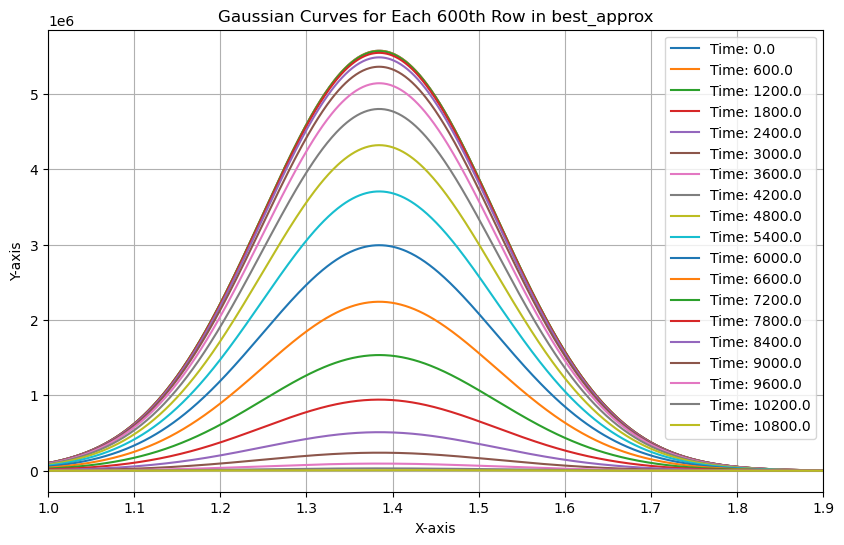

In [13]:
# Plot Gaussian curves for each 600th row
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

for i in range(0, len(best_approx), 600):
    row = best_approx.iloc[i]
    x_values = np.linspace(0, 10, 7500)  # Adjust the range as needed
    y_values = gaussian(x_values, row['A'], row['B'], row['C'])
    plt.plot(x_values, y_values, label=f'Time: {row["Time (s)"]}')

plt.xlabel('X-axis')  # Replace with your actual x-axis label
plt.ylabel('Y-axis')  # Replace with your actual y-axis label
plt.title('Gaussian Curves for Each 600th Row in best_approx')
plt.xlim(1, 1.9)
plt.legend()
plt.grid(True)
plt.show()

In [93]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np


# Define the Gaussian function
def gaussian(x, A, B, C):
    return A * np.exp(-((x - B)**2) / (2 * C**2))

# Create a Plotly figure
fig = go.Figure()

# Plot Gaussian curves for each 600th row
for i in range(0, len(best_approx), 600):
    row = best_approx.iloc[i]
    x_values = np.linspace(0, 10, 10000)  # Adjust the range as needed
    y_values = gaussian(x_values, row['A'], row['B'], row['C'])
    fig.add_trace(go.Scatter(x=x_values, y=y_values, mode='lines', name=f'Time: {row["Time (s)"]}'))

# Update layout
fig.update_layout(
    xaxis_title='X-axis',  # Replace with your actual x-axis label
    yaxis_title='Y-axis',  # Replace with your actual y-axis label
    title='Gaussian Curves for Each 600th Row in best_approx',
    xaxis=dict(range=[1, 1.9]),  # Set x-axis range
    legend=dict(x=0, y=1, traceorder='normal')  # Adjust legend position
)

fig.show()


## Integrals

In [30]:
initial = pd.read_excel('results_gauss_integr.xlsx')

In [31]:
preds  = pd.read_excel('GLM4_integrs.xlsx')

In [43]:
preds_1  = pd.read_excel('все модели\Ridge\Ridge_2.xlsx')

In [44]:
preds_1['Gaussian_Area'] = preds_1.apply(integrate_gaussian, axis=1)

In [32]:
preds_2  = pd.read_excel('все модели\Elastic Net CV\Elastic Net CV_2.xlsx')

In [35]:
preds_2['Gaussian_Area'] = preds_2.apply(integrate_gaussian, axis=1)

In [36]:
preds_3  = pd.read_excel('все модели\Lasso\Lasso_3.xlsx')

In [37]:
preds_3['Gaussian_Area'] = preds_3.apply(integrate_gaussian, axis=1)


In [38]:
'все модели\Quantile Regression\Quantile Regression_4.xlsx'

'все модели\\Quantile Regression\\Quantile Regression_4.xlsx'

In [39]:
initial

,Unnamed: 0.1,Unnamed: 0,Filename,A,B,C,Time (s),Gaussian_Area
0,0,0,00000001.txt,6.016165e+06,1.383070,0.134680,0.036606,1.436139e+06
1,1,1,00000002.txt,5.996164e+06,1.382989,0.134886,0.536500,1.433557e+06
2,2,2,00000003.txt,6.010415e+06,1.382889,0.134970,1.036430,1.437855e+06
3,3,3,00000004.txt,5.999819e+06,1.382968,0.134904,1.536421,1.434628e+06
4,4,4,00000005.txt,6.002321e+06,1.382615,0.135196,2.036358,1.438327e+06
...,...,...,...,...,...,...,...,...
7175,7175,7175,00007176.txt,5.223600e+06,1.385339,0.136119,3587.154000,1.260271e+06
7176,7176,7176,00007177.txt,5.223475e+06,1.385518,0.135866,3587.656000,1.257902e+06
7177,7177,7177,00007178.txt,5.213699e+06,1.385069,0.136473,3588.161000,1.261154e+06
7178,7178,7178,00007179.txt,5.222123e+06,1.385309,0.136355,3588.654000,1.262095e+06


In [40]:
preds_2 = preds_2[preds_2['Gaussian_Area'] > 0]
preds_2

,Unnamed: 0,Time (s),A,B,C,Gaussian_Area
0,0,0,5.805188e+06,1.383732,0.135521,1.394433e+06
1,1,1,5.805188e+06,1.383732,0.135521,1.394433e+06
2,2,2,5.805188e+06,1.383732,0.135521,1.394433e+06
3,3,3,5.805188e+06,1.383732,0.135521,1.394433e+06
4,4,4,5.805187e+06,1.383732,0.135521,1.394433e+06
...,...,...,...,...,...,...
10410,10410,10410,4.567722e+03,1.400537,0.146015,1.182148e+03
10411,10411,10411,3.453236e+03,1.400540,0.146017,8.937260e+02
10412,10412,10412,2.338643e+03,1.400544,0.146019,6.052685e+02
10413,10413,10413,1.223943e+03,1.400547,0.146021,3.167754e+02


In [41]:
preds_3 = preds_3[preds_3['Gaussian_Area'] > 0]
preds_3

,Unnamed: 0,Time (s),A,B,C,Gaussian_Area
0,0,0,6.006621e+06,1.383425,0.135143,1.438797e+06
1,1,1,6.006291e+06,1.383425,0.135143,1.438718e+06
2,2,2,6.005961e+06,1.383425,0.135143,1.438639e+06
3,3,3,6.005631e+06,1.383425,0.135143,1.438560e+06
4,4,4,6.005302e+06,1.383425,0.135143,1.438481e+06
...,...,...,...,...,...,...
10620,10620,10620,8.030793e+03,1.314663,0.040018,5.696214e+02
10621,10621,10621,6.382934e+03,1.314638,0.039985,4.523711e+02
10622,10622,10622,4.734711e+03,1.314614,0.039953,3.352851e+02
10623,10623,10623,3.086124e+03,1.314589,0.039920,2.183635e+02


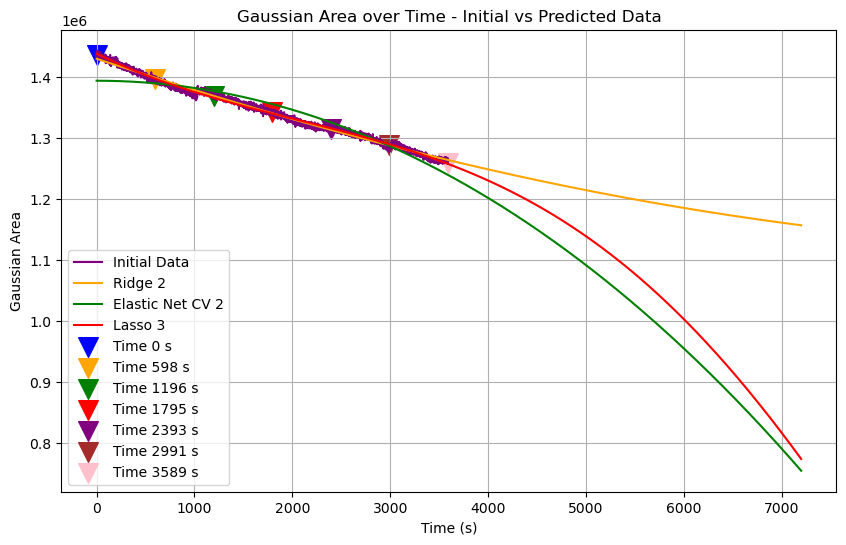

In [73]:
import matplotlib.pyplot as plt

# Assuming df_initial and df_preds are your DataFrames
#indices = [0, 1196, 2393, 3590, 4786, 5983, 7180]

plt.figure(figsize=(10, 6))

# Plot Gaussian_Area for df_initial
plt.plot(initial['Time (s)'], initial['Gaussian_Area'], label='Initial Data', color='purple')

# Plot Gaussian_Area for df_preds
plt.plot(preds_1['Time (s)'][0:7200], preds_1['Gaussian_Area'][0:7200], label='Ridge 2', color='orange')
plt.plot(preds_2['Time (s)'][0:7200], preds_2['Gaussian_Area'][0:7200], label='Elastic Net CV 2', color='green')
plt.plot(preds_3['Time (s)'][0:7200], preds_3['Gaussian_Area'][0:7200], label='Lasso 3', color='red')

# Plot dots for the specified indexes with different colors and "V" marker style
indexes = [i for i in [0, 1196, 2393, 3590, 4786, 5983, 7179]]
dot_colors = ['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink']
for i, index in enumerate(indexes):
    plt.scatter(initial['Time (s)'].iloc[index], initial['Gaussian_Area'].iloc[index], 
                color=dot_colors[i], marker='v', s=200, label=f'Time {indexes[i]//2} s')

# Create a new legend for dots
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xlabel('Time (s)')
plt.ylabel('Gaussian Area')
plt.title('Gaussian Area over Time - Initial vs Predicted Data')
plt.legend()
plt.grid(True)
plt.savefig(f'areas.pdf')
plt.show()


In [47]:
initial['Time (s)']

0          0.036606
1          0.536500
2          1.036430
3          1.536421
4          2.036358
           ...     
7175    3587.154000
7176    3587.656000
7177    3588.161000
7178    3588.654000
7179    3589.154000
Name: Time (s), Length: 7180, dtype: float64

In [55]:
initial['Time (s)'].iloc[indexes]

IndexError: positional indexers are out-of-bounds